In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
# Set paths
fasta_folder = os.path.join(os.getcwd(), os.pardir, 'data', 'raw-data', 'fasta')
interim_folder = os.path.join(os.getcwd(), os.pardir, 'data', 'interim')
img_folder = os.path.join(os.getcwd(), os.pardir, 'reports', 'figures')

In [3]:
# Define organisms dataset to be used
organisms_names = (
        'Arabidopsis_non_tata',
        'Arabidopsis_tata',
        'Bacillus',
        'Ecoli',
        'Human_non_tata',
        'Mouse_non_tata',
        'Mouse_tata',
    )

In [4]:
# Utility functions

def get_organism_props_dataframes(organism_path: str):
    # Get all properties files from organism folder
    props_files = [f'{organism_path}/{file}' for file in os.listdir(organism_path) if file.startswith('df_data_prop_')]

    # Get dataframes for each property
    props = list()
    for prop_idx in range(len(props_files)):
        prop_file = f'{organism_path}/df_data_prop_{prop_idx}.csv'
        if os.path.exists(prop_file):
            df_data = pd.read_csv(prop_file, index_col=False)
            props.append(df_data)
        else:
            print(f'Property {prop_idx} csv file not found.')

    return props

def get_bp_positions(seq_len: int):
    # Set range of bp positions (upstream, TSS, downstream)
    if seq_len <= 81:
        _range = np.arange(-60, 30, 20)
    else:
        _range = np.arange(-200, 60, 20)
    return _range

def get_props_names(kmer_type: str = 'dinuc'):
    kmers_values_folder = os.path.join(os.getcwd(), os.pardir, 'data', 'raw-data',
                                       'physicochemical-properties-reference',
                                           f'{kmer_type}.tsv')
    kmer_df = pd.read_csv(kmers_values_folder, sep='\t', index_col=0)
    props_names = kmer_df.index.tolist()
    return props_names



In [5]:
# Set kmer type, get properties names and number of properties for that kmer type
kmer_types = ('dinuc', 'trinuc')
kmer_type = kmer_types[1] # Select kmer type
props_names =  get_props_names(kmer_type=kmer_type)
n_props = len(props_names)
print(f'Kmer: {kmer_type} | Number of properties: {n_props}')
print(f'Properties: {props_names}')

Kmer: trinuc | Number of properties: 12
Properties: ['Bendability (DNAse) ', 'Bendability (consensus)', 'Trinucleotide GC Content', 'Nucleosome positioning', 'Consensus_roll', 'Consensus-Rigid', 'Dnase I', 'Dnase I-Rigid', 'MW-Daltons', 'MW-kg', 'Nucleosome', 'Nucleosome-Rigid']


In [6]:
# Create folder to save kmers images if it doesn't exist
kmer_img_folder = os.path.join(img_folder, f'{kmer_type}')
if not os.path.exists(kmer_img_folder):
    os.makedirs(kmer_img_folder)

In [11]:
organisms_properties_features = dict()
for organism_name in organisms_names:
    # organism_feature_folder = os.path.join(interim_folder, organism_name)
    organism_feature_folder = os.path.join(interim_folder, kmer_type, f'{organism_name}-original')
    props_dataframes = get_organism_props_dataframes(organism_path=organism_feature_folder)
    organisms_properties_features[organism_name] = props_dataframes

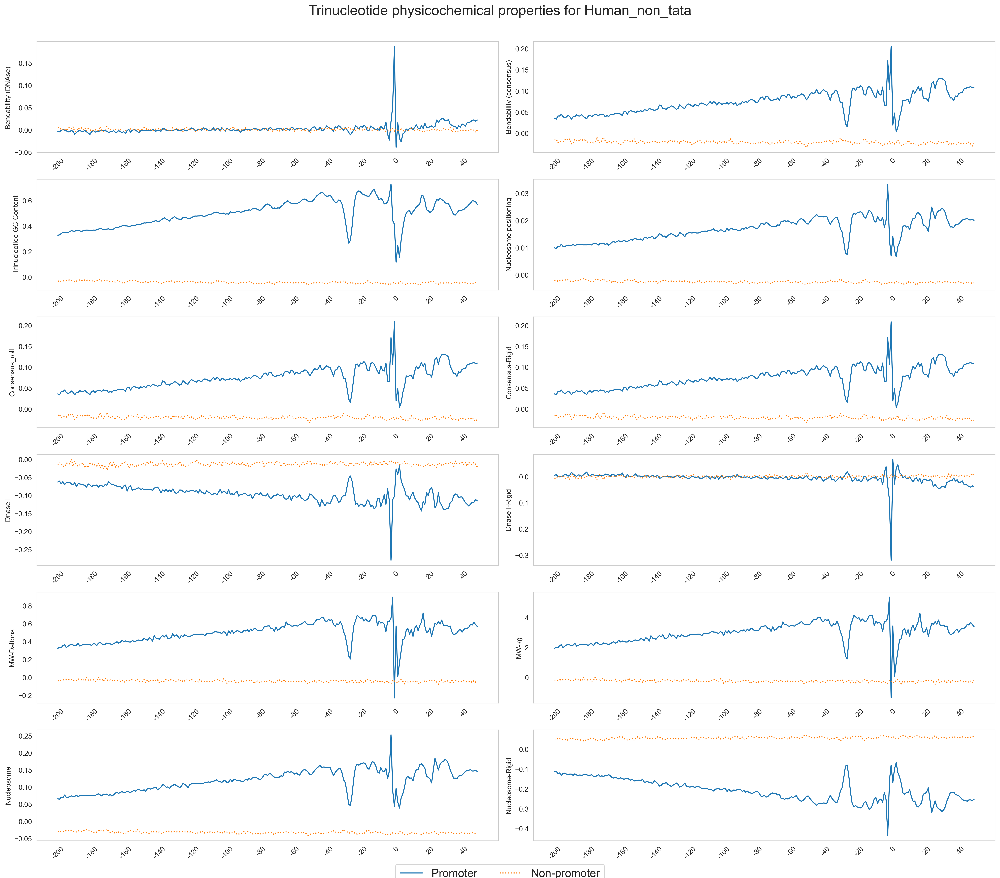

Organism Mouse_non_tata | Sequence length: 250 | xlabels: [-200 -180 -160 -140 -120 -100  -80  -60  -40  -20    0   20   40]


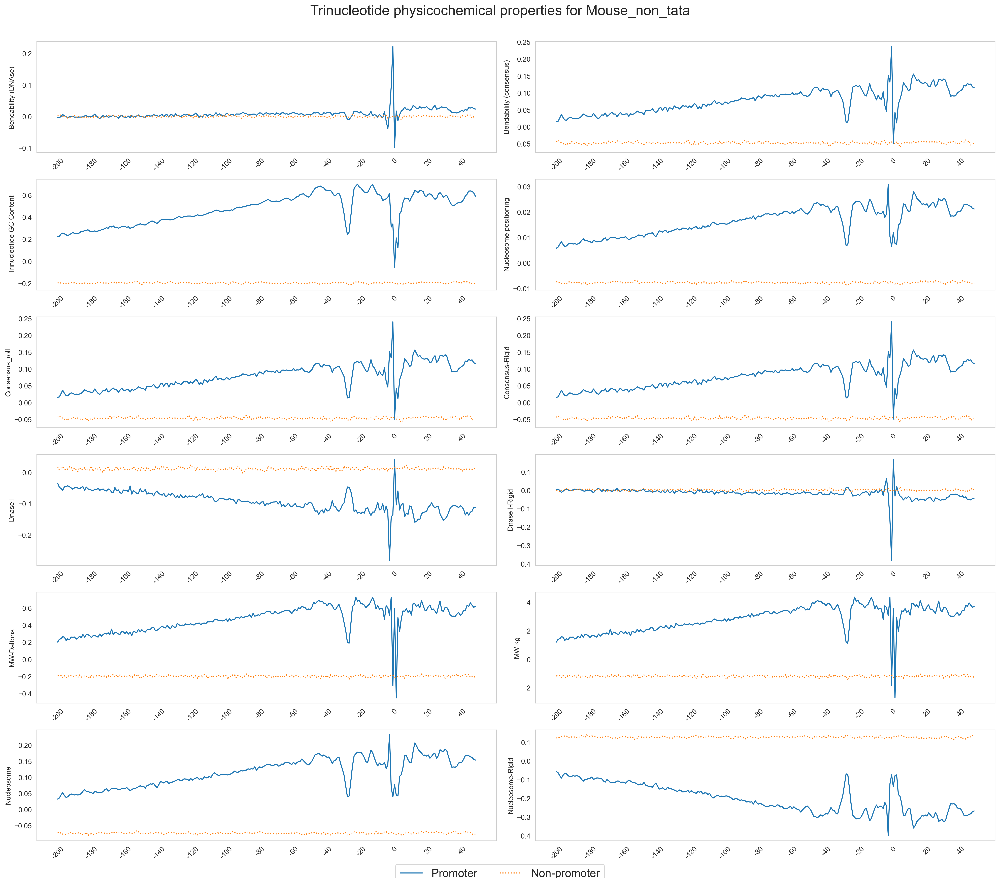

Organism Mouse_tata | Sequence length: 250 | xlabels: [-200 -180 -160 -140 -120 -100  -80  -60  -40  -20    0   20   40]


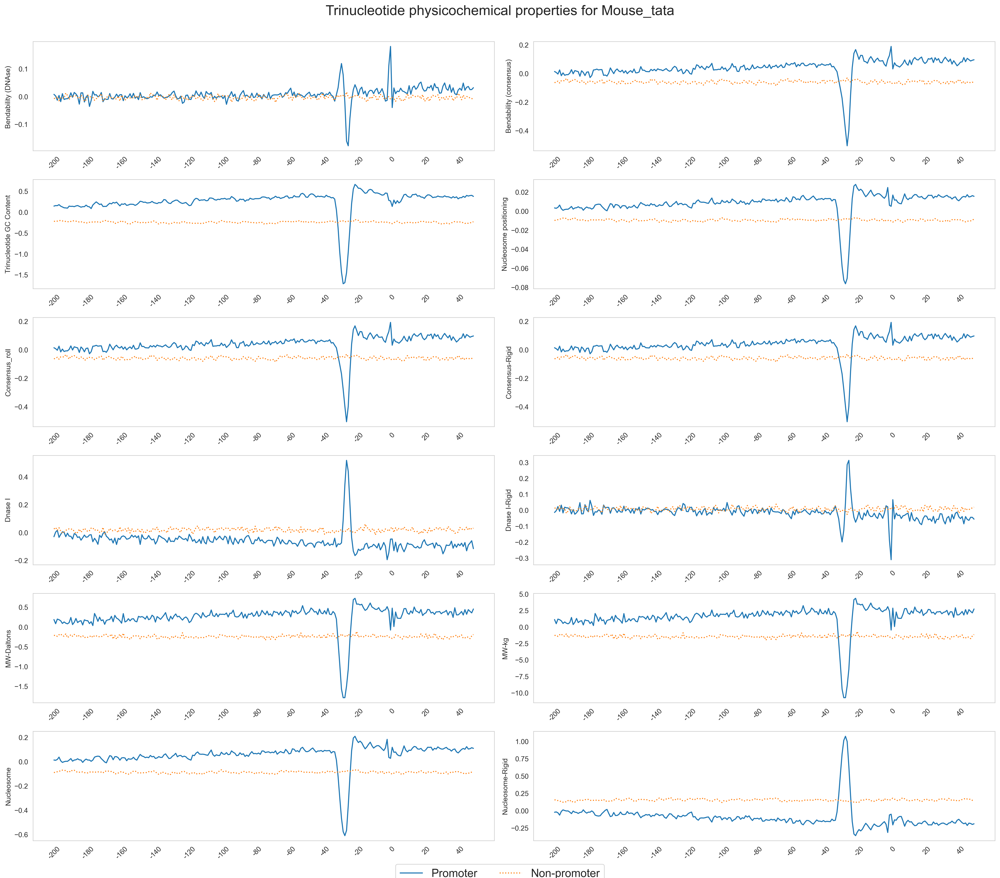

Organism Arabidopsis_non_tata | Sequence length: 250 | xlabels: [-200 -180 -160 -140 -120 -100  -80  -60  -40  -20    0   20   40]


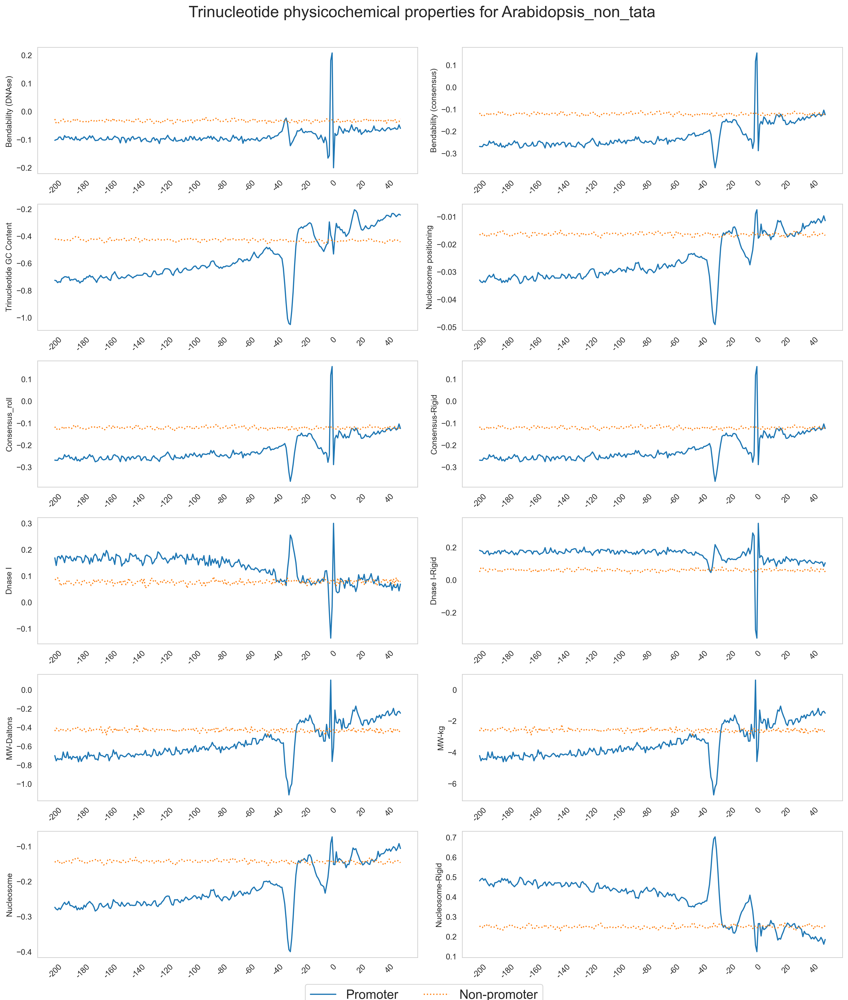

Organism Arabidopsis_tata | Sequence length: 250 | xlabels: [-200 -180 -160 -140 -120 -100  -80  -60  -40  -20    0   20   40]


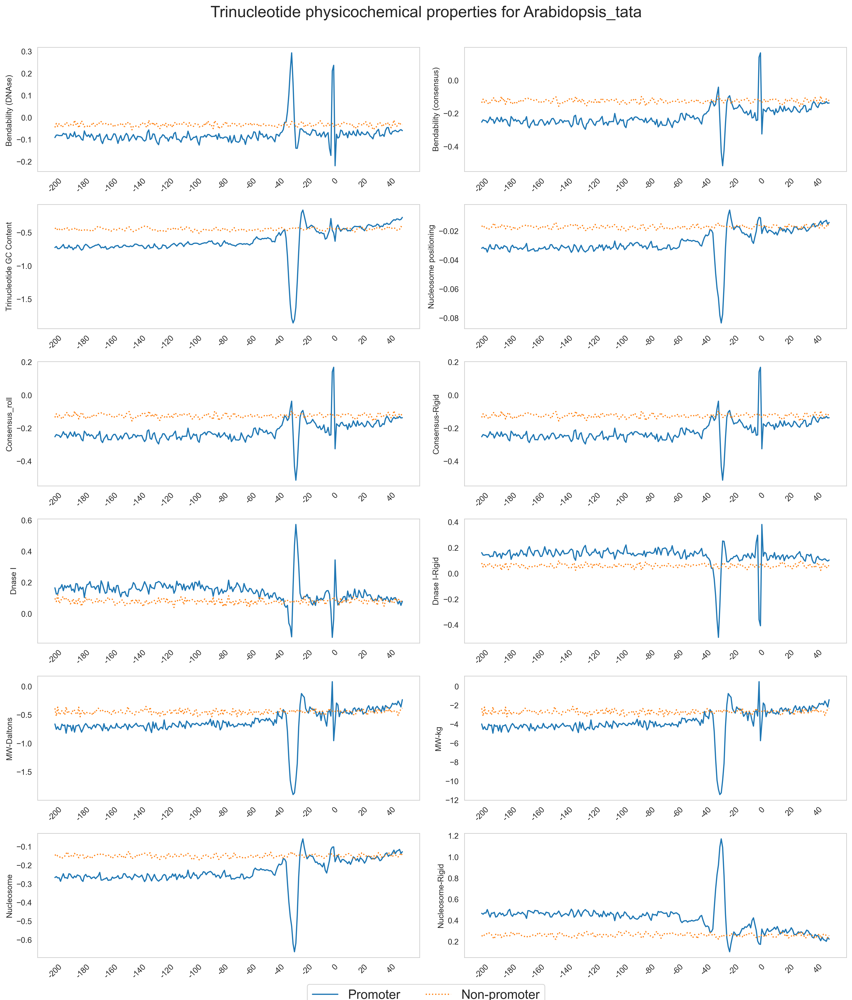

Organism Bacillus | Sequence length: 80 | xlabels: [-60 -40 -20   0  20]


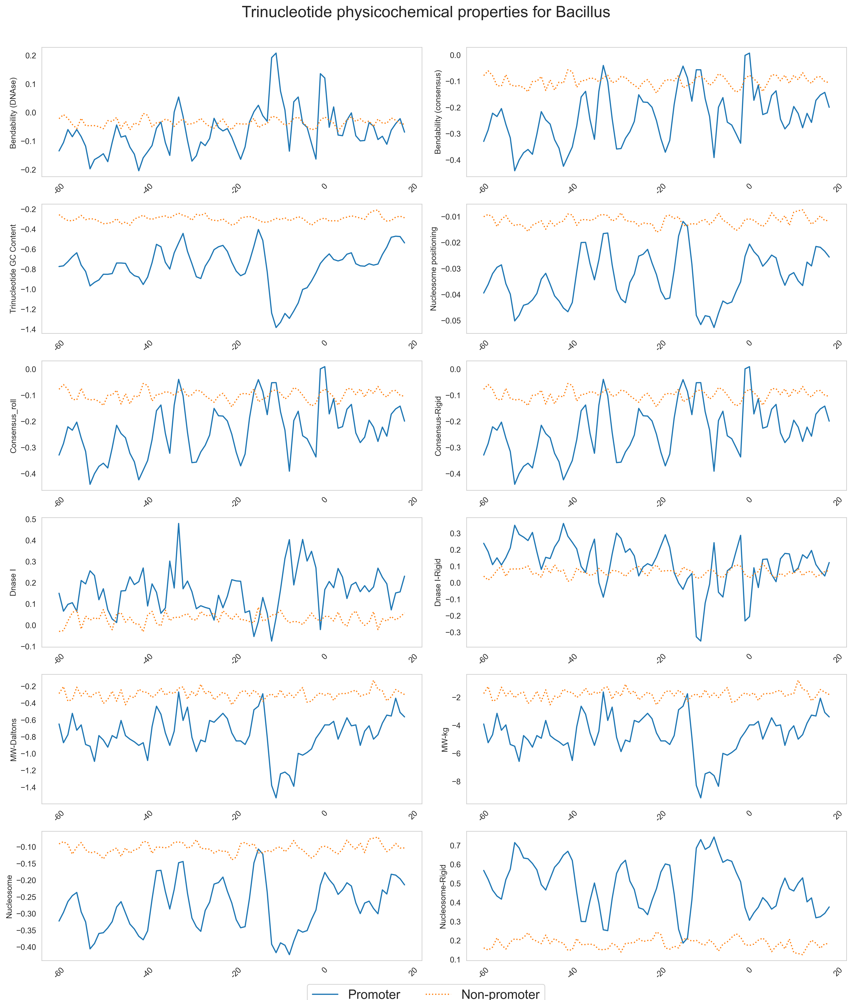

Organism Ecoli | Sequence length: 80 | xlabels: [-60 -40 -20   0  20]


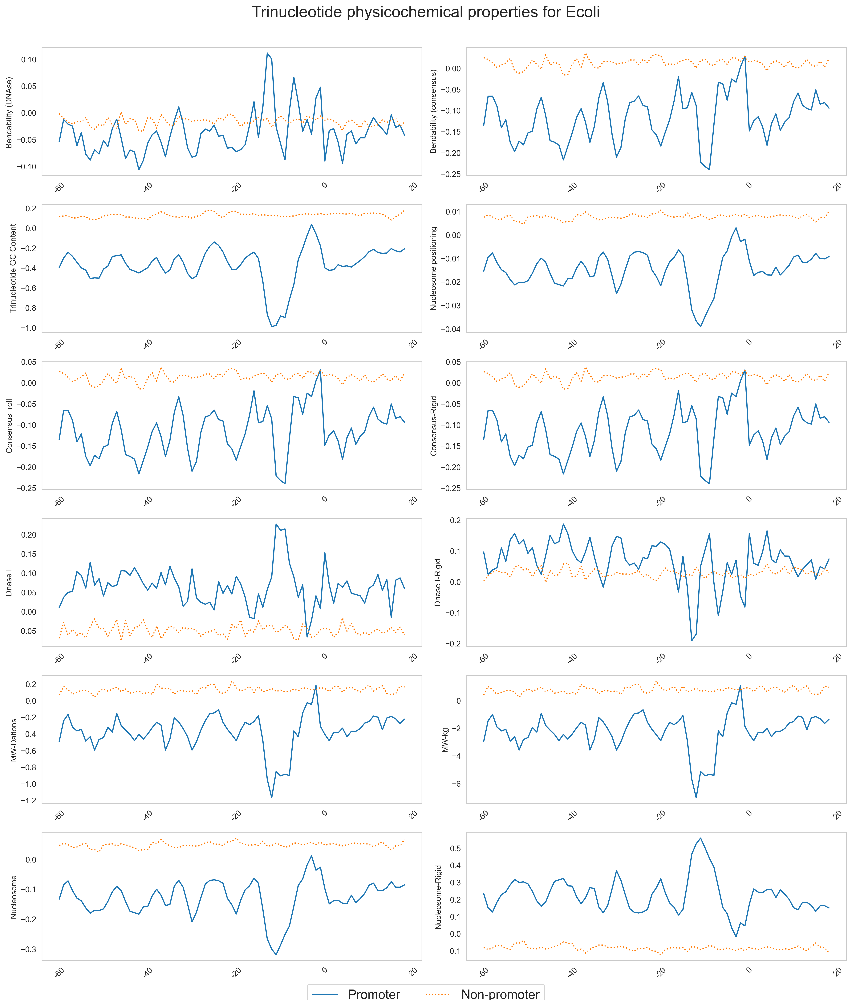

Organism Human_non_tata | Sequence length: 250 | xlabels: [-200 -180 -160 -140 -120 -100  -80  -60  -40  -20    0   20   40]


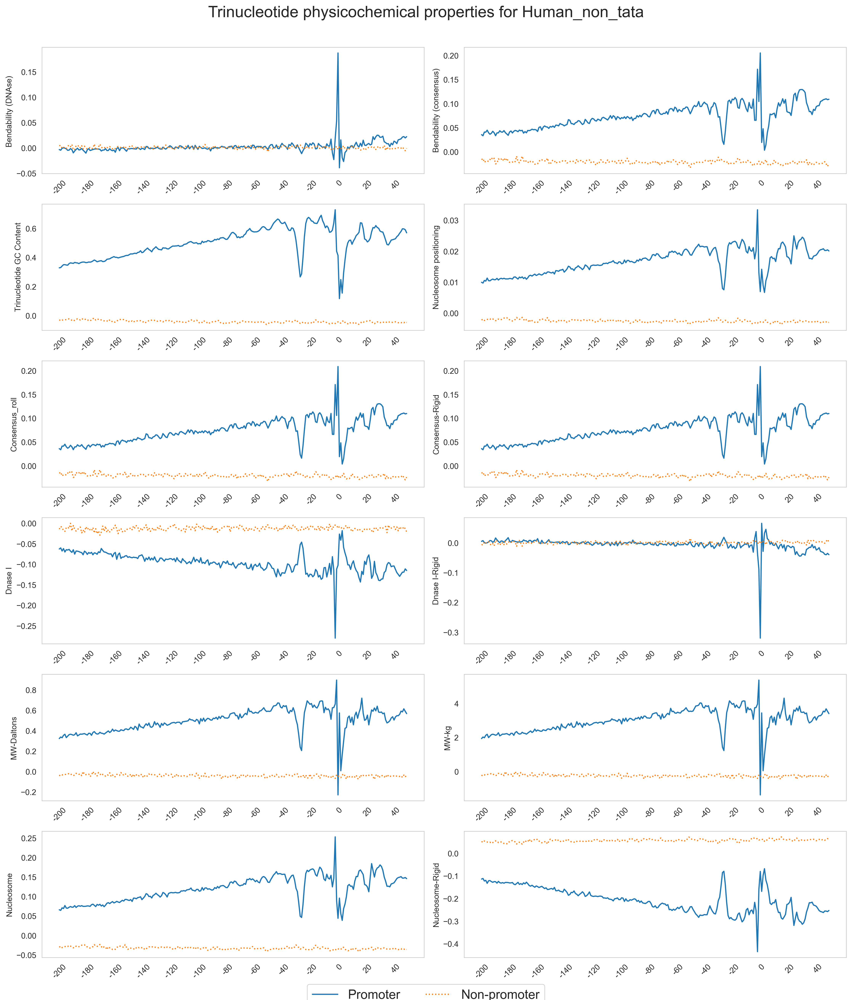

Organism Mouse_non_tata | Sequence length: 250 | xlabels: [-200 -180 -160 -140 -120 -100  -80  -60  -40  -20    0   20   40]


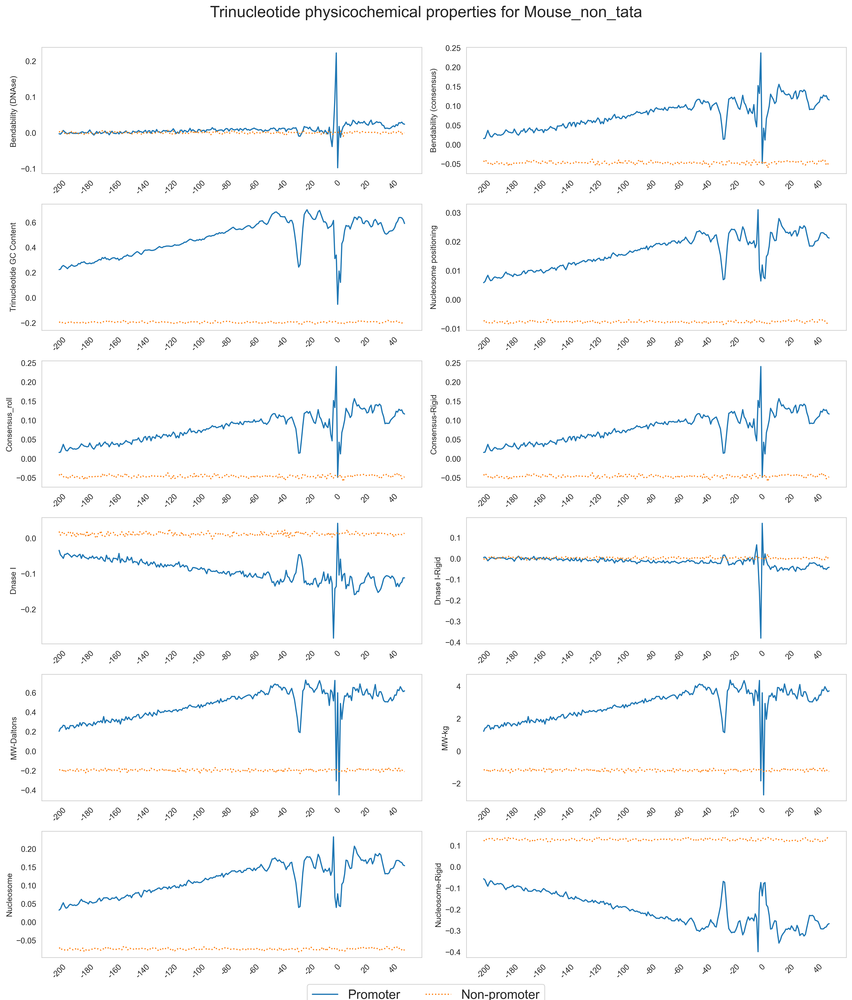

Organism Mouse_tata | Sequence length: 250 | xlabels: [-200 -180 -160 -140 -120 -100  -80  -60  -40  -20    0   20   40]


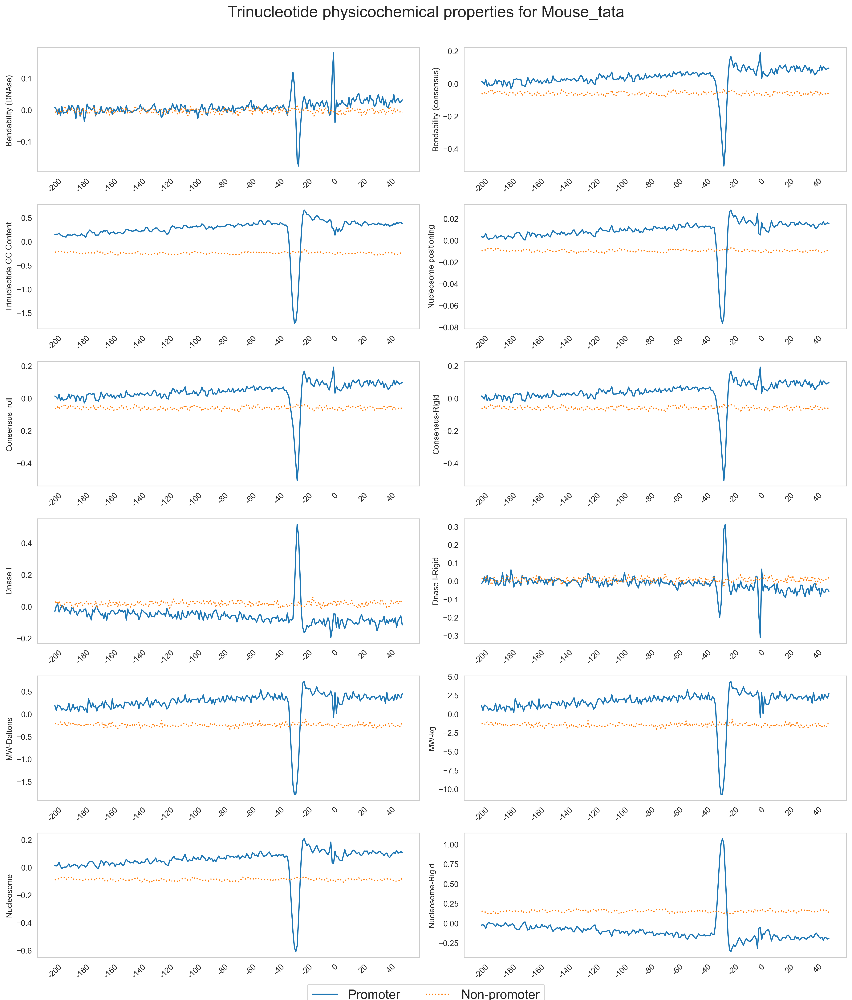

In [16]:
pos_means = dict()
neg_means = dict()
for organism_name, props_dataframes in organisms_properties_features.items():
    seq_len = props_dataframes[0].shape[1]
    xlabels_ = get_bp_positions(seq_len=seq_len)
    print(f'Organism {organism_name} | Sequence length: {seq_len} | xlabels: {xlabels_}')

    pos_means[organism_name] = list()
    neg_means[organism_name] = list()

    _ncols = 2
    _nrows = int(np.ceil(n_props / _ncols))
    _figsize = (15, 17)

    # fig = plt.figure(figsize=_figsize, constrained_layout=True, dpi=300, facecolor='w', edgecolor='k')
    fig = plt.figure(figsize=_figsize, constrained_layout=True, dpi=300)
    # plt.subplots_adjust(hspace=0.5)
    # fig.suptitle("Daily closing prices", fontsize=18, y=0.95)

    # loop through the length of props_names and keep track of index
    for prop_idx, prop_name in enumerate(props_names):
        # add a new subplot iteratively
        ax = plt.subplot(_nrows, _ncols, prop_idx + 1)

        org_df = props_dataframes[prop_idx]
        n_classes = org_df['y'].unique().shape[0]

        if n_classes == 2:
            pos_df = org_df[org_df['y'] == 1]
            neg_df = org_df[org_df['y'] == 0]
        elif n_classes == 3:
            pos_df = org_df[org_df['y'] == 2]
            neg_df = org_df[org_df['y'] == 1]

        pos_df = pos_df.drop(columns=['y'])
        neg_df = neg_df.drop(columns=['y'])

        p_mean = pos_df.mean()
        n_mean = neg_df.mean()

        pos_means[organism_name].append(p_mean)
        neg_means[organism_name].append(n_mean)

        plt.plot(p_mean, label='Promoter', linestyle='solid')
        plt.plot(n_mean, label='Non-promoter', linestyle='dotted')

        # chart formatting
        plt.xticks(np.arange(0, pos_df.shape[1]+10, 20), labels=xlabels_, rotation=45)
        plt.grid(False)
        ax.set_xlabel("")
        ax.set_ylabel(f'{prop_name}')


    title_aux = 'Dinucleotide' if kmer_type == 'dinuc' else 'Trinucleotide'
    fig.suptitle(f'{title_aux} physicochemical properties for {organism_name}', fontsize=20, y=1.01)
    lines_labels = [fig.axes[-1].get_legend_handles_labels()]
    lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
    fig.legend(lines, labels, loc='lower center', fancybox=True, ncol=2, fontsize=16, borderaxespad=-0.5)
    fig.tight_layout()

    img_name = f'{organism_name}_{title_aux.lower()}_physicochemical_profiles.svg'
    img_path = os.path.join(kmer_img_folder, img_name)
    plt.savefig(img_path, dpi=300, bbox_inches='tight', pad_inches=0.1)

    plt.show()

In [ ]:
n_samples = {'promoters': list(), 'non-promoters': list()}
for organism_name, props_dataframes in organisms_properties_features.items():
    org_df = props_dataframes[0]

    n_classes = org_df['y'].unique().shape[0]

    if n_classes == 2:
        n_pos = org_df[org_df['y'] == 1].shape[0]
        n_neg = org_df[org_df['y'] == 0].shape[0]
    elif n_classes == 3:
        n_pos = org_df[org_df['y'] == 2].shape[0]
        n_neg = org_df[org_df['y'] == 1].shape[0]

    n_samples['promoters'].append(n_pos)
    n_samples['non-promoters'].append(n_neg)

    print(f'Organism: {organism_name} | n_pos: {n_pos} | n_neg: {n_neg}')

In [ ]:
# Plot number of promoters and non-promoters in multiple bar plot
fig = plt.figure(figsize=(4, 5), constrained_layout=True, dpi=300)
ax = plt.subplot(1, 1, 1)
plt.bar(organisms_names, n_samples['non-promoters'], label='Non-promoters',
        color='coral')
plt.bar(organisms_names, n_samples['promoters'], label='Promoters', color='cornflowerblue',
        bottom=n_samples['non-promoters'])
plt.xticks(rotation=90)
plt.grid(False)
ax.set_xlabel("")
ax.set_ylabel("Number of samples")
plt.yscale('log')
plt.legend(loc='best', fancybox=True)
plt.tight_layout()
plt.show()

In [ ]:
x = np.arange(len(organisms_names))  # the label locations
width = 0.25  # the width of the bars
multiplier = 0

fig, ax = plt.subplots(layout='constrained', dpi=300)

for attribute, measurement in n_samples.items():
    offset = width * multiplier
    rects = ax.bar(x + offset, measurement, width, label=attribute)
    ax.bar_label(rects, padding=3, fontsize=8, rotation=0)
    multiplier += 1.25

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Number of samples')
# ax.set_xlabel('')
ax.set_title('Number of samples by dataset')
ax.set_xticks(x + width, organisms_names, rotation=90)
ax.legend(loc='best', ncols=2)
ax.set_ylim(0, 30500)
ax.grid(False)

fig_path = os.path.join(img_folder, 'n_samples_by_dataset.svg')
plt.savefig(fig_path, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()